### Batch Correction
In this notebook we will attempt some batch correction steps as exploration using BBKNN and ComBat. Also will attempt some Regress-out to explore affect on neighbours/clusters.
We will perform all steps on the original adata directly from QC_Merge_notebook, and also on the adata with all non-microglia removed from the analysis1_notebook.

lets begin with the original Adata. 


In [70]:
import numpy as np
import scanpy as sc
import scanpy.external as sce
import anndata as ad
import matplotlib.pyplot as plt
from bbknn import bbknn


# Modify the sys.path to include the notebook directory to import functions
import sys
import os

notebook_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
if notebook_dir not in sys.path:
    sys.path.append(notebook_dir)

import func_lib as f

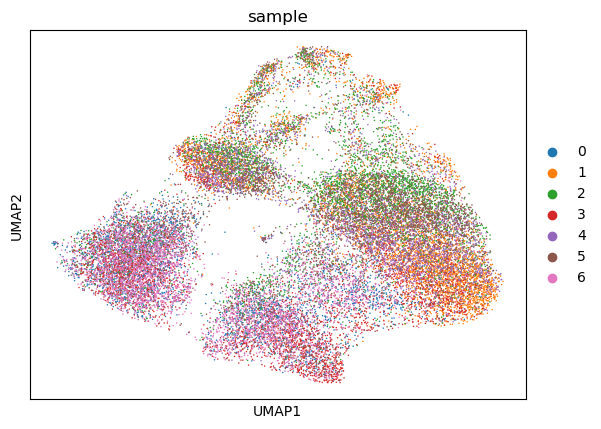

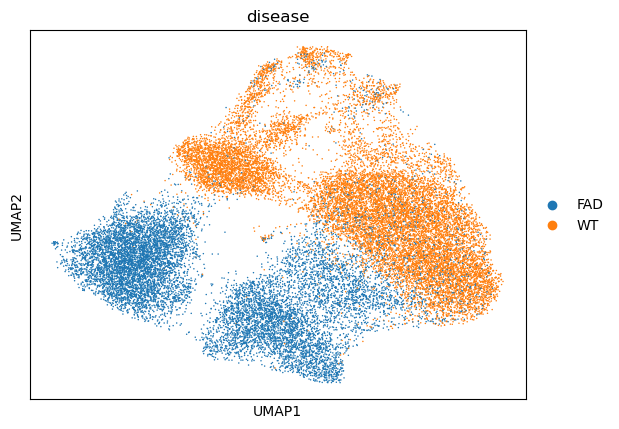

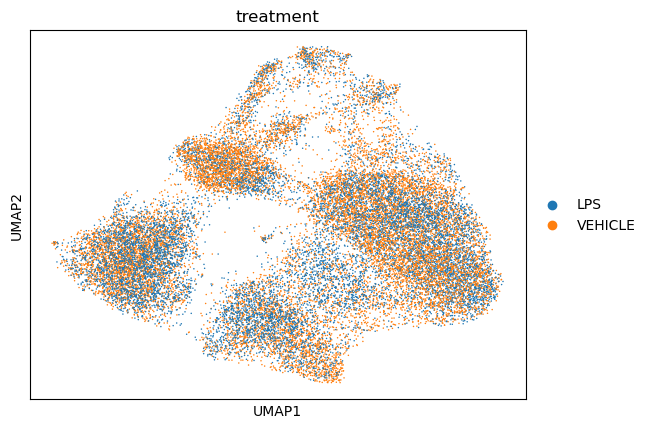

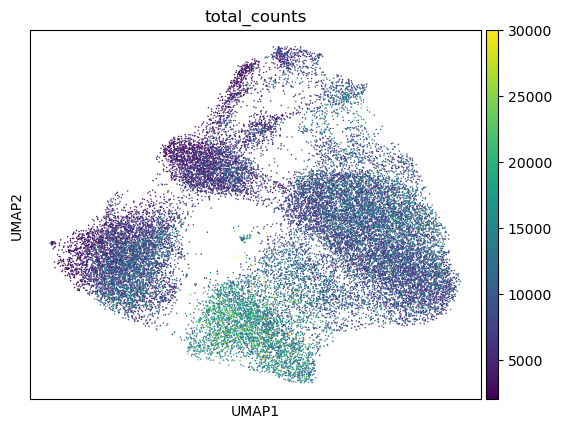

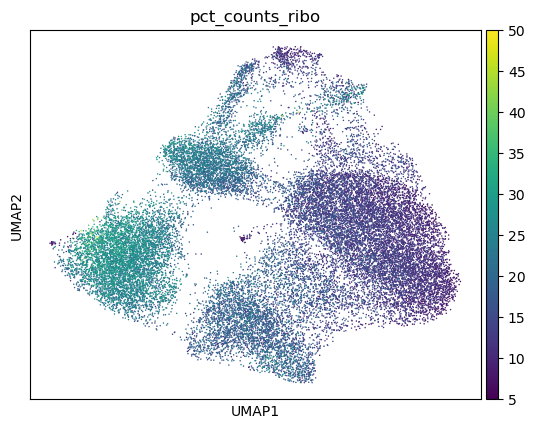

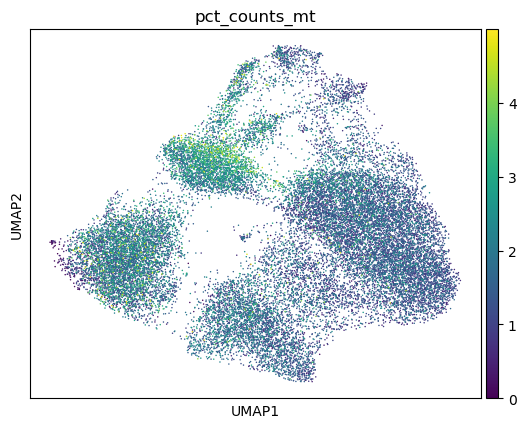

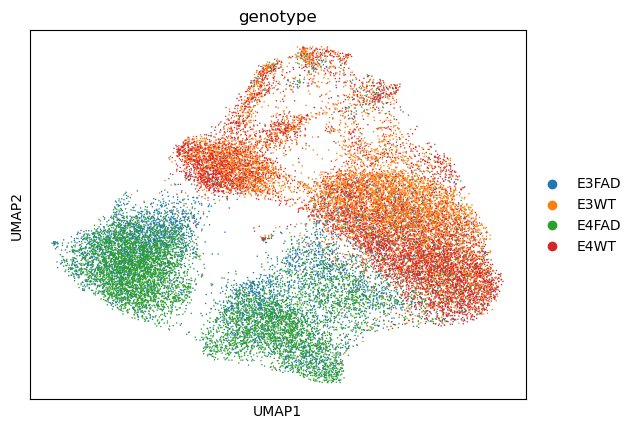

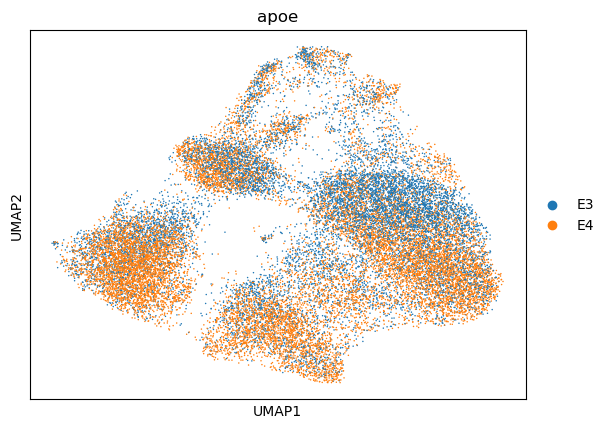

AttributeError: PathCollection.set() got an unexpected keyword argument 'log'

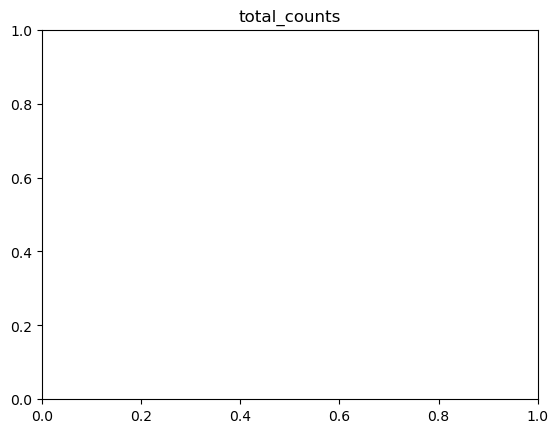

In [79]:
# First we load the data from the h5ad file
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()
sc.pp.pca(adata_full, n_comps=50)
sc.pp.neighbors(adata_full, n_pcs=25)
sc.tl.umap(adata_full)
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='total_counts', vmin=2000, vmax=30000)
sc.pl.umap(adata_full, color='pct_counts_ribo')
sc.pl.umap(adata_full, color='pct_counts_mt')
sc.pl.umap(adata_full, color='genotype')
sc.pl.umap(adata_full, color='apoe')

# lets log the total_counts to see if we can see the differences better
sc.pl.umap(adata_full, color='total_counts', log=True, vmin=1, vmax=5)


In [3]:
#Reload data
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

# Full Adata 
## Harmony

2024-10-11 13:00:36,143 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-10-11 13:00:37,639 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-10-11 13:00:37,688 - harmonypy - INFO - Iteration 1 of 10
2024-10-11 13:00:40,326 - harmonypy - INFO - Iteration 2 of 10
2024-10-11 13:00:43,037 - harmonypy - INFO - Converged after 2 iterations


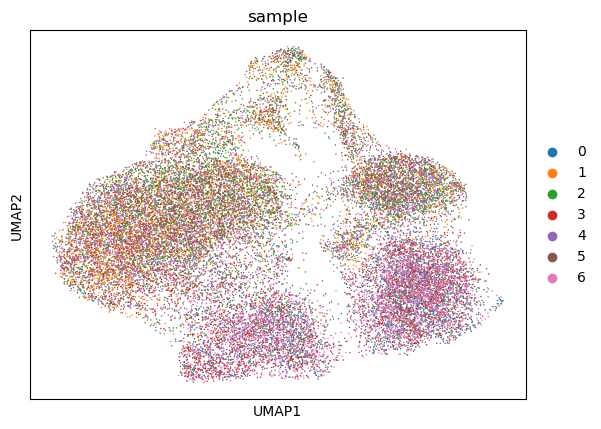

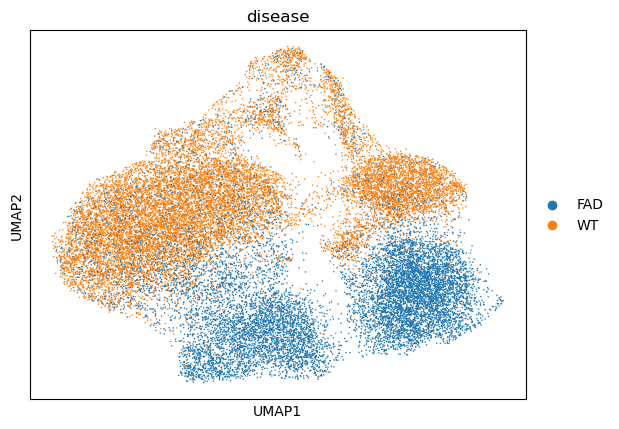

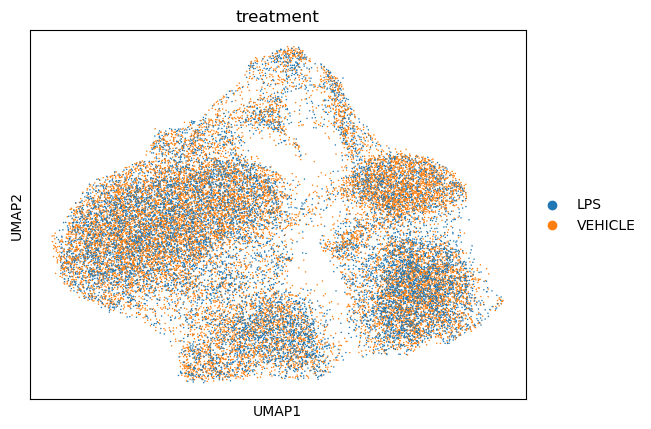

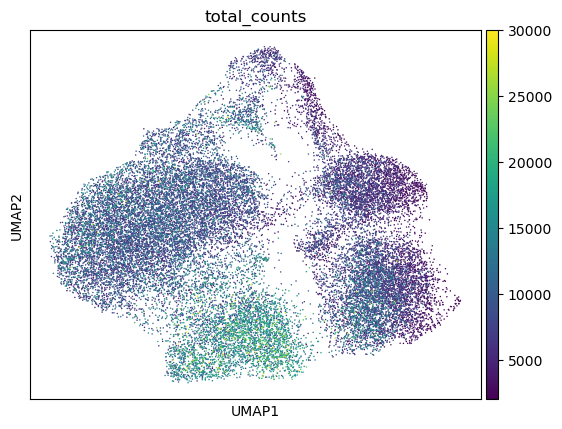

In [78]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')

sce.pp.harmony_integrate(adata_full, 'sample')

sc.pp.neighbors(adata_full, n_pcs=15, use_rep='X_pca_harmony')

sc.tl.umap(adata_full)

sc.pl.umap(adata_full, color='sample')

sc.pl.umap(adata_full, color='disease')

sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='total_counts', vmin=2000, vmax=30000)


## BBKNN

In [4]:
# First we load the data from the h5ad file
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

# check the data
print(adata_full)

# check Current Layer, should not be normalized

print(adata_full.X.toarray().max())

AnnData object with n_obs × n_vars = 26309 × 17352
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'n_genes', 'Classification', 'most_likely_hypothesis', 'sample', 'genotype', 'apoe', 'disease', 'treatment', 'norm_total_counts'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'log1p'
    layers: 'counts', 'log_norm'
2480.0


7.610413


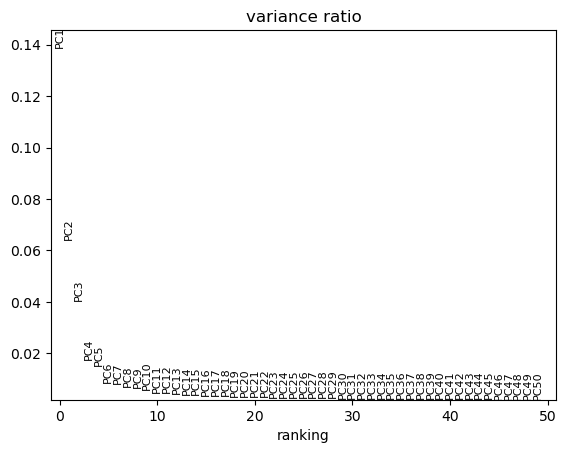

In [5]:
# start by changing the Layer to log_norm
adata_full.X = adata_full.layers['log_norm'].copy()
print(adata_full.X.toarray().max())

# Now we will run the PCA
sc.pp.pca(adata_full)
sc.pl.pca_variance_ratio(adata_full, n_pcs=50)

In [6]:
bbknn(adata_full, batch_key='sample', n_pcs=15)

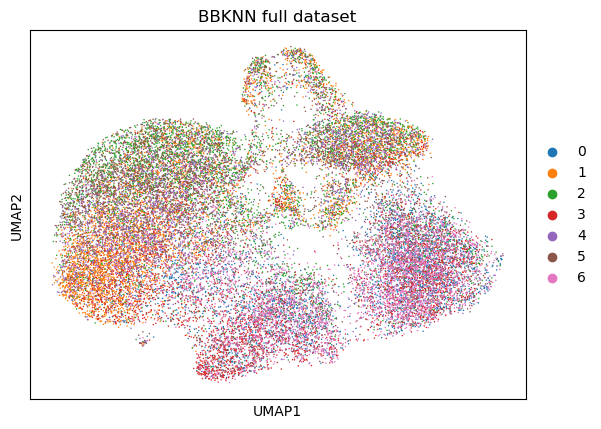

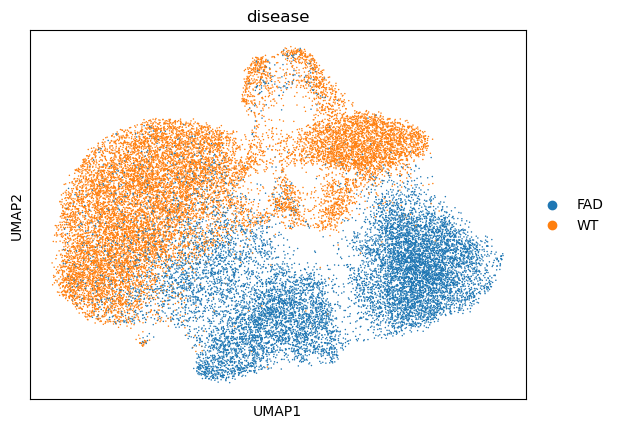

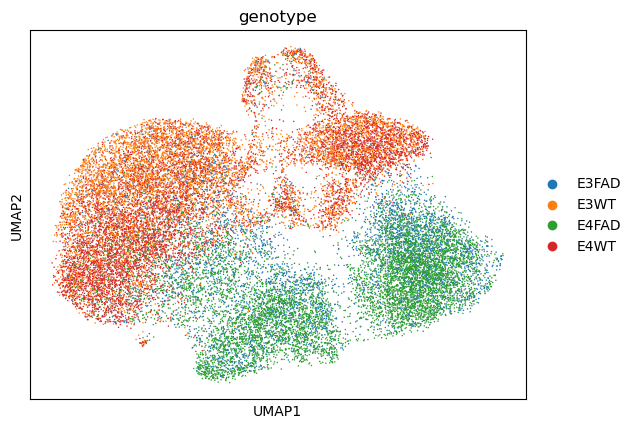

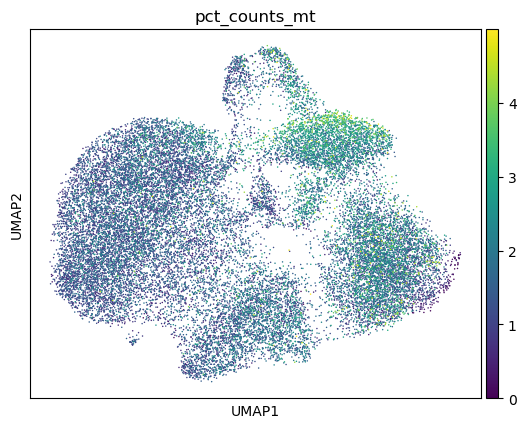

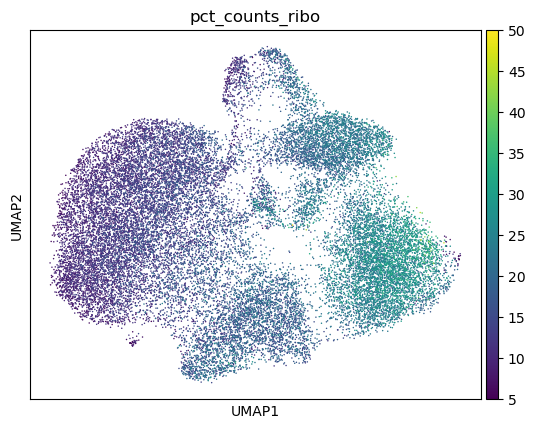

In [7]:
sc.tl.umap(adata_full)
sc.pl.umap(adata_full, color='sample', title='BBKNN full dataset')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='genotype')
sc.pl.umap(adata_full, color='pct_counts_mt')
sc.pl.umap(adata_full, color='pct_counts_ribo')

In [8]:
# save the bbknn corrected data as a anndata object
bbknn_corrected = adata_full.copy()

# Save the data to a new h5ad file
adata_full.write_h5ad('Bbknn_corrected.h5ad')

# Reload the data from the original h5ad file into adata_full
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')



## ComBat

In [9]:

adata_full.X = adata_full.layers['log_norm'].copy()

adata_full.X = adata_full.X.toarray()

# Find genes with zero variance
zero_variance_genes = np.var(adata_full.X, axis=0) == 0

# Print the number of zero variance genes
print(f"Number of zero variance genes: {zero_variance_genes.sum()}")

Number of zero variance genes: 0


In [10]:


sc.pp.combat(adata_full, key='sample')


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_combat.py:352: RuntimeWarning: divide by zero encountered in divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()


In [11]:
print(np.isinf(adata_full.X).sum())

0


In [12]:
print(np.isnan(adata_full.X).sum())

0


Highly variable genes: 1356


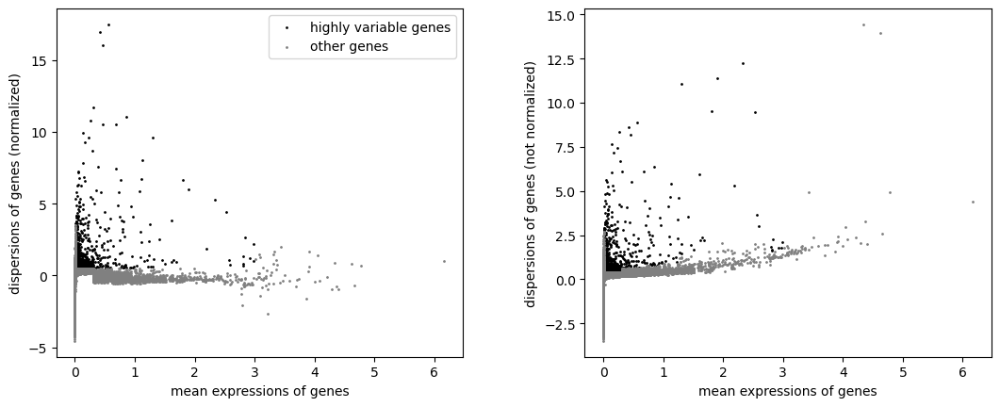

In [13]:

sc.pp.highly_variable_genes(adata_full)
print("Highly variable genes: %d"%sum(adata_full.var.highly_variable))
sc.pl.highly_variable_genes(adata_full)

sc.pp.pca(adata_full, mask_var="highly_variable", svd_solver='arpack')


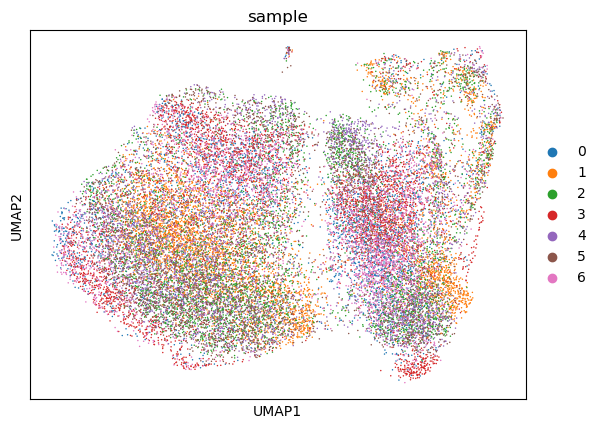

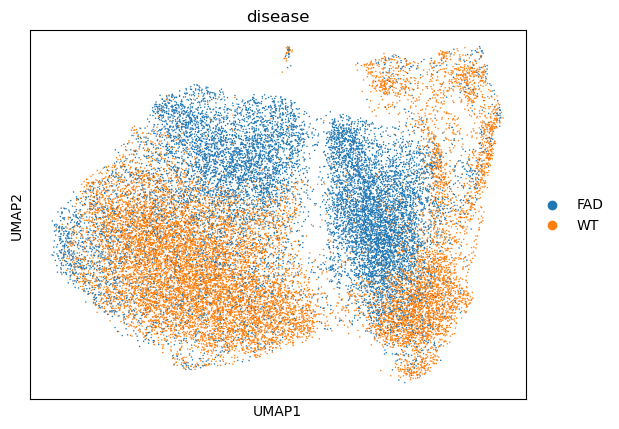

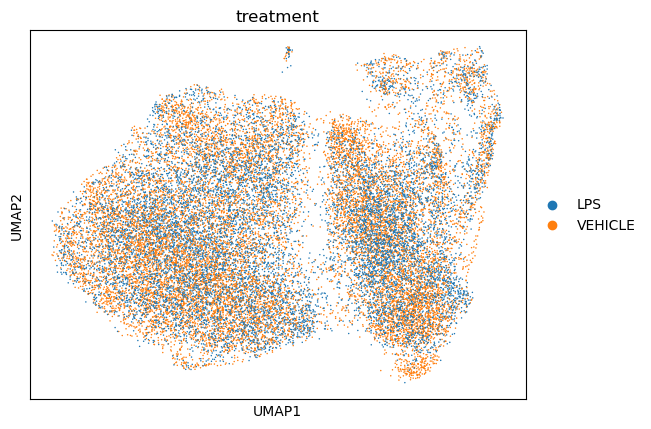

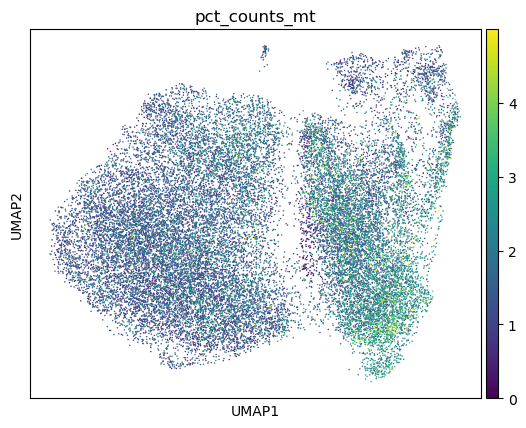

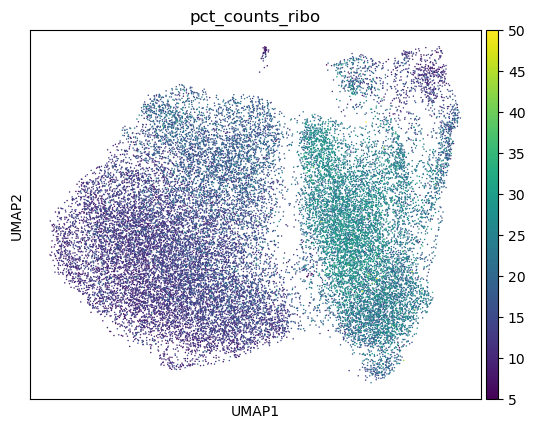

In [14]:

sc.pp.neighbors(adata_full, n_pcs=15, use_rep='X_pca')

sc.tl.umap(adata_full)
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_mt')
sc.pl.umap(adata_full, color='pct_counts_ribo')

In [15]:
# save the Combat corrected data as a anndata object
Combat_corrected = adata_full.copy()

#Save the Combat corrected data
adata_full.write('../QC_Merge/Combat_corrected.h5ad')

# Reload the data from the original h5ad file into adata_full
adata_full = ''

## Regress-out

### Mitochondrial

In [16]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

In [17]:
sc.pp.regress_out(adata_full, 'pct_counts_mt')

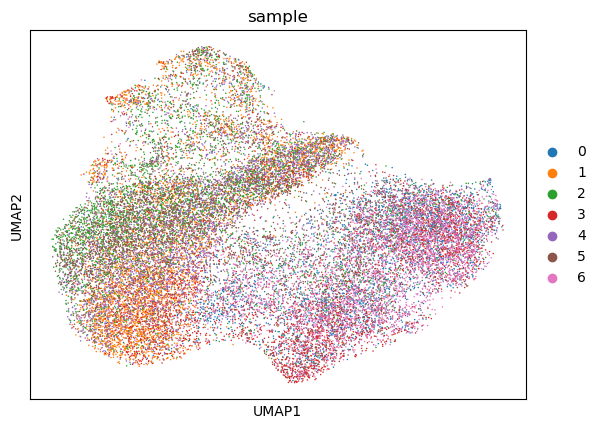

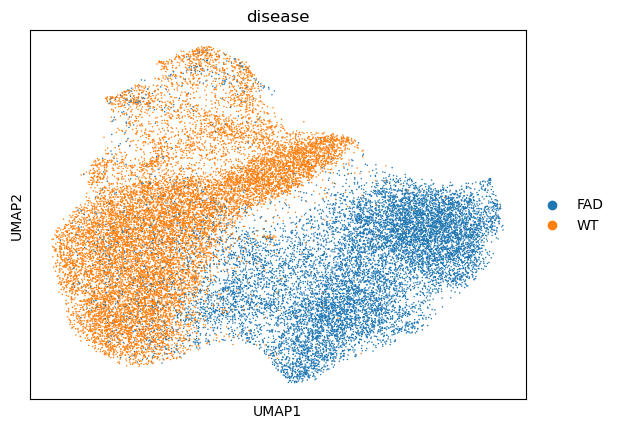

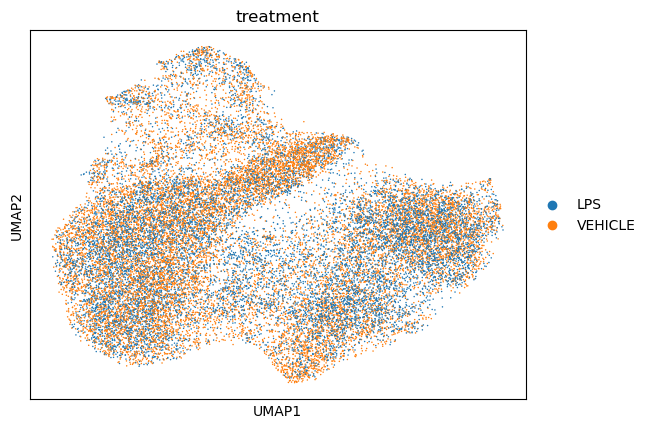

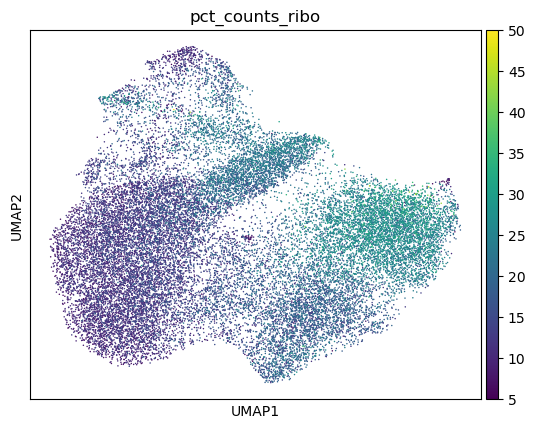

In [18]:
sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata_full, n_pcs=15)
sc.tl.umap(adata_full)
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')


### Regrees mito on bbknn corrected

7.610413


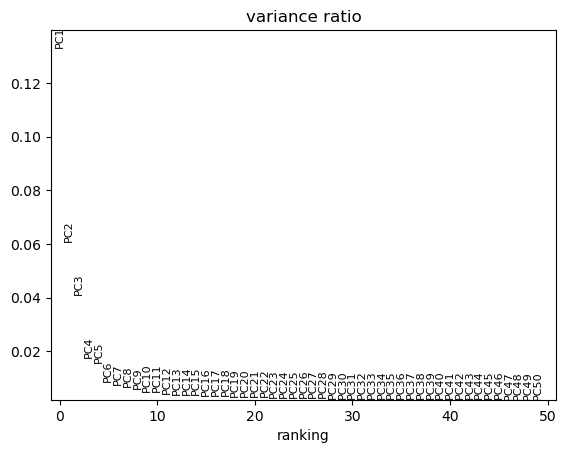

In [19]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')
# start by changing the Layer to log_norm
adata_full.X = adata_full.layers['log_norm'].copy()
print(adata_full.X.toarray().max())
#Regress out the pct_counts_mt
sc.pp.regress_out(adata_full, 'pct_counts_mt')
# Now we will run the PCA
sc.pp.pca(adata_full)
sc.pl.pca_variance_ratio(adata_full, n_pcs=50)
bbknn(adata_full, batch_key='sample', n_pcs=15)
sc.tl.umap(adata_full)

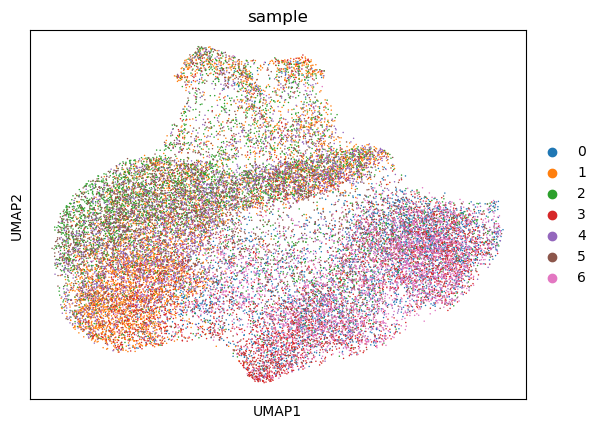

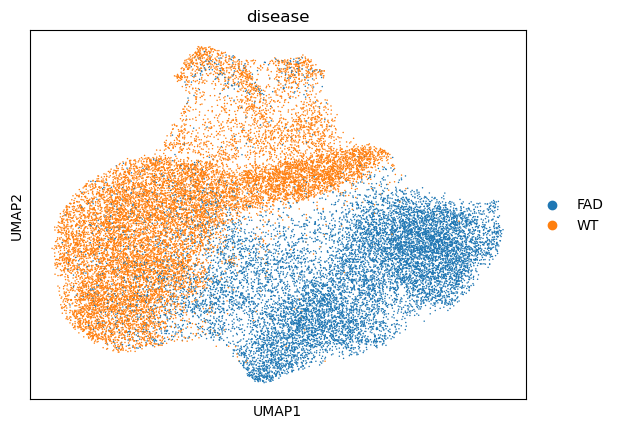

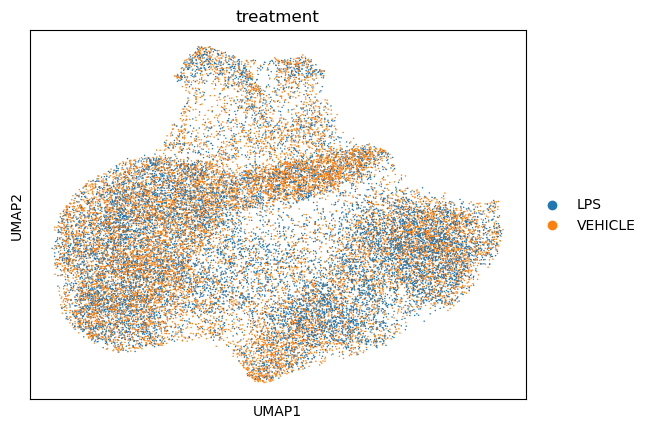

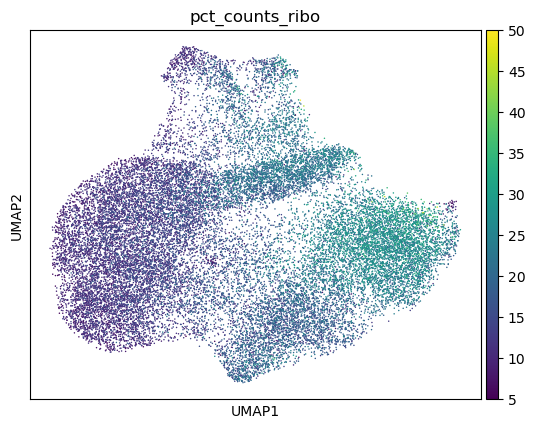

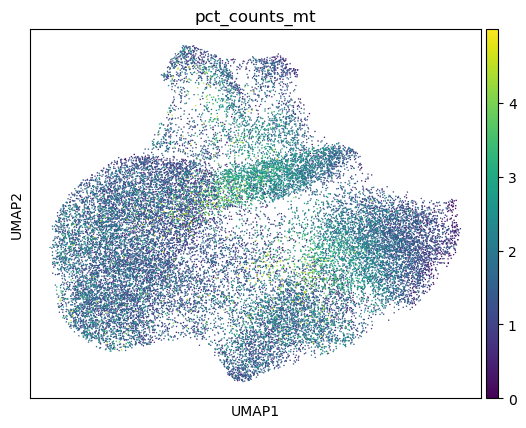

In [20]:

sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')
sc.pl.umap(adata_full, color='pct_counts_mt')
sc.pl.umap(adata_full, color='manual_annotation')

### Regrees mito on combat corrected

In [21]:
#Load the data from Combat_corrected
adata_full = sc.read_h5ad('../QC_Merge/Combat_corrected.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

In [22]:
#Regress out the pct_counts_mt
sc.pp.regress_out(adata_full, 'pct_counts_ribo')

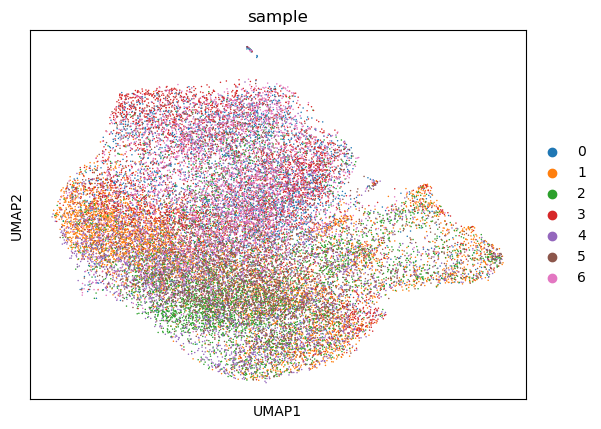

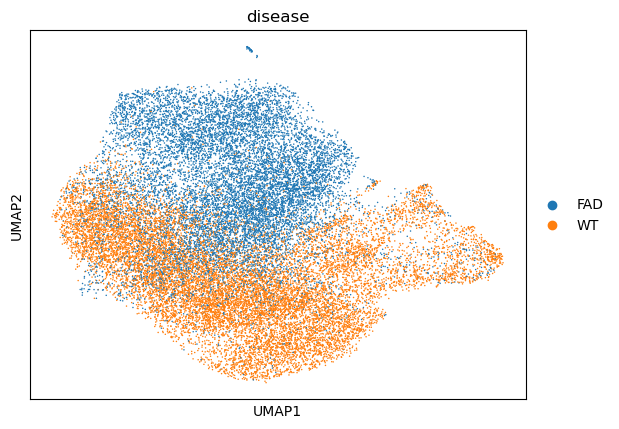

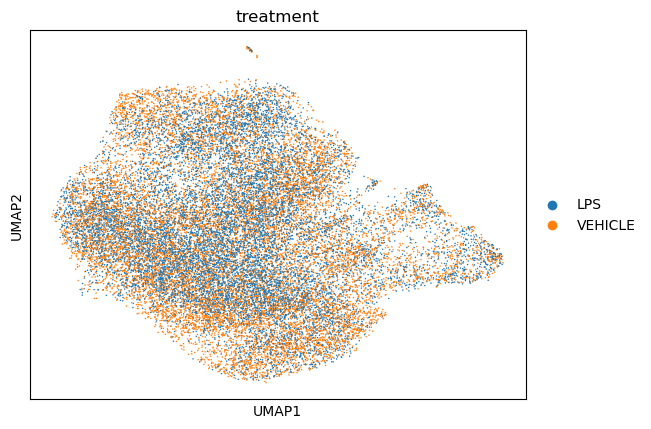

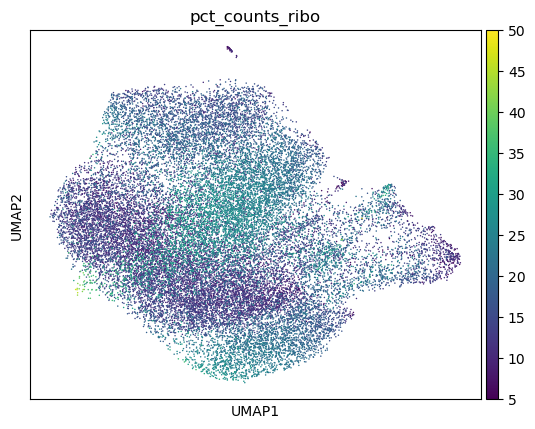

KeyError: 'Could not find key manual_annotation in .var_names or .obs.columns.'

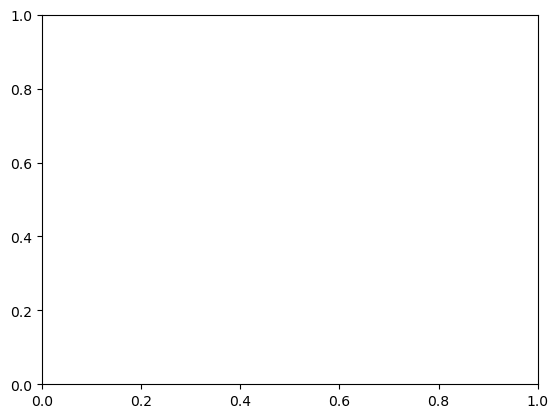

In [27]:
#Run PCA
sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')
#Run Neighbors
sc.pp.neighbors(adata_full, n_pcs=15)
#Run UMAP
sc.tl.umap(adata_full)
#Plot UMAP
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')

### Ribosomal

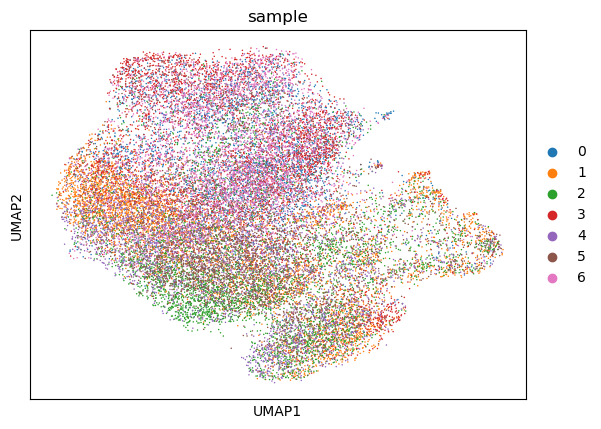

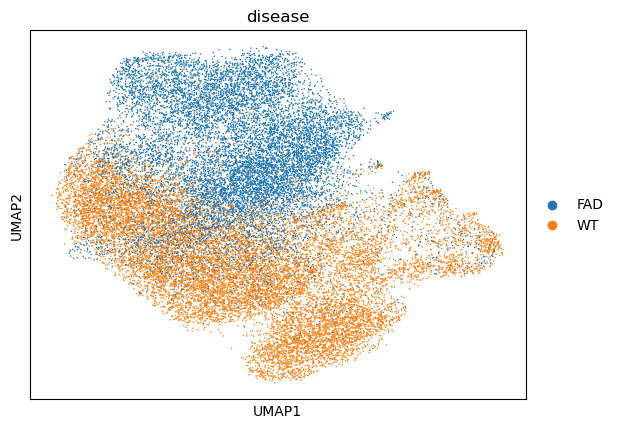

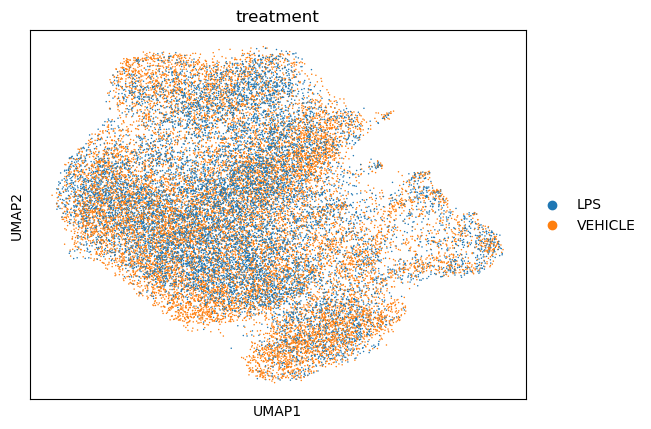

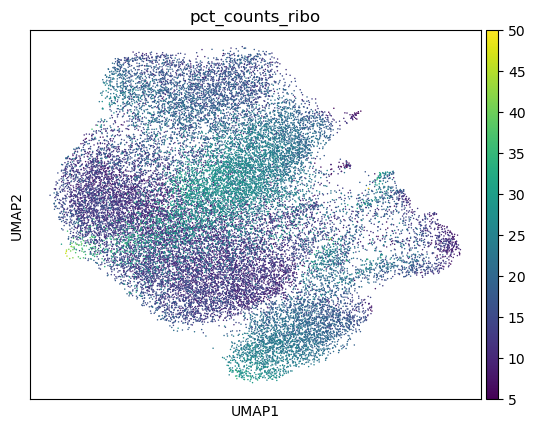

In [25]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

sc.pp.regress_out(adata_full, 'pct_counts_ribo')

#Run PCA
sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')
#Run Neighbors
sc.pp.neighbors(adata_full, n_pcs=15)
#Run UMAP
sc.tl.umap(adata_full)
#Plot UMAP
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')

### Ribo + MT

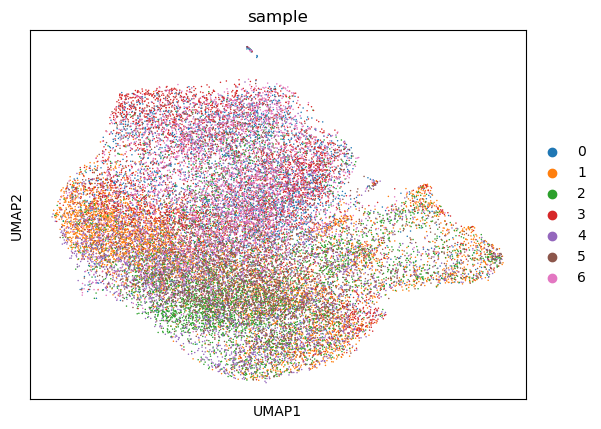

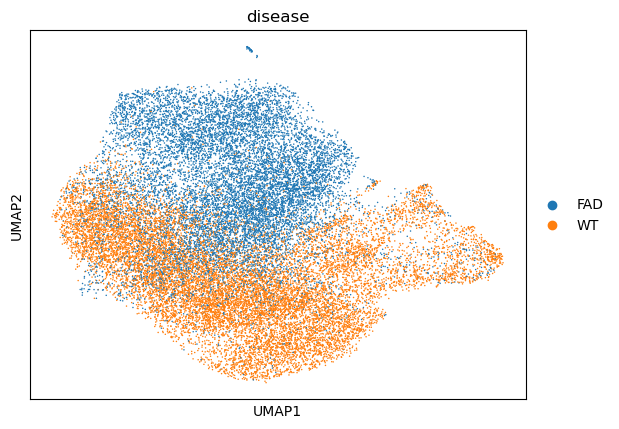

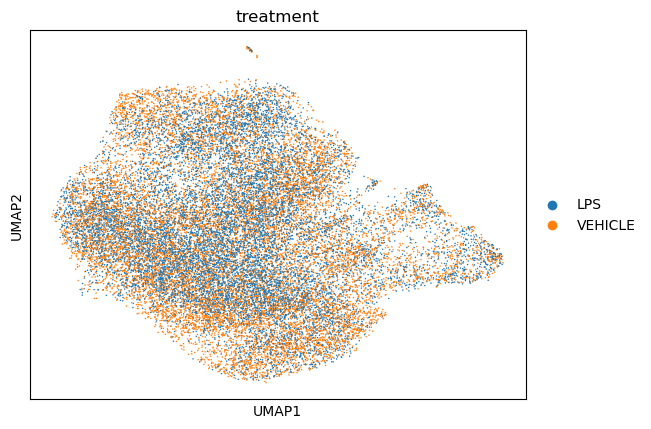

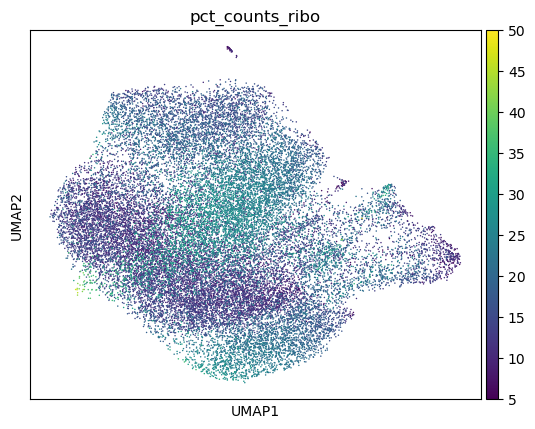

In [26]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

sc.pp.regress_out(adata_full, ['pct_counts_ribo', 'pct_counts_mt'])

#Run PCA
sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')
#Run Neighbors
sc.pp.neighbors(adata_full, n_pcs=15)
#Run UMAP
sc.tl.umap(adata_full)
#Plot UMAP
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')

### Total Counts 

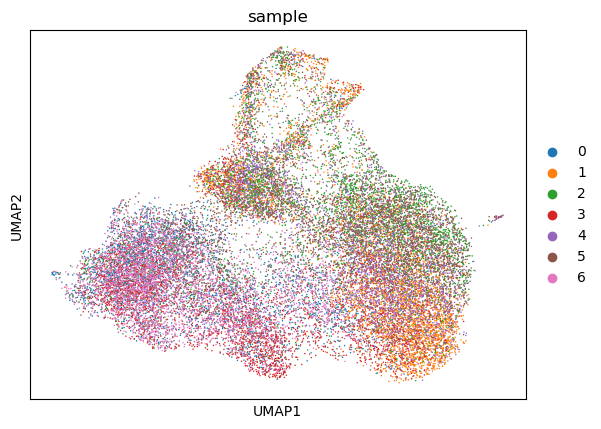

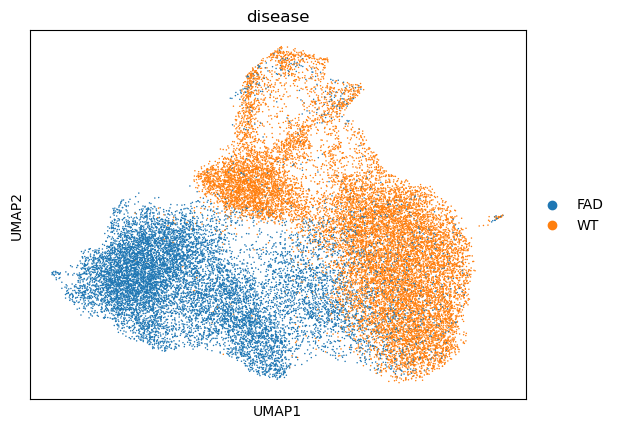

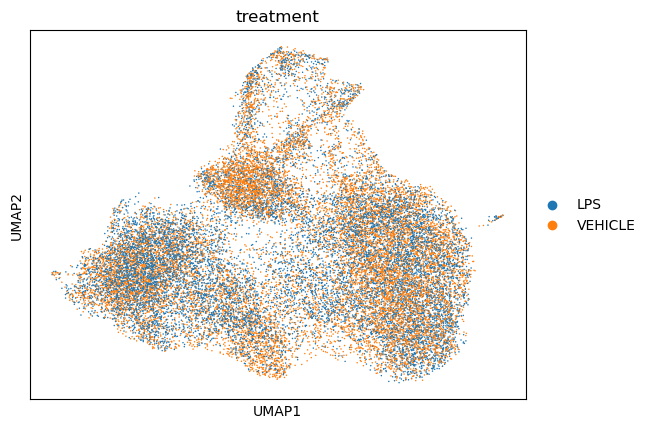

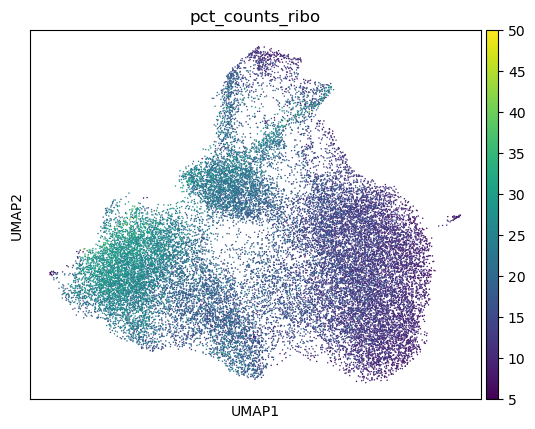

In [29]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

sc.pp.regress_out(adata_full, 'total_counts')

#Run PCA
sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')
#Run Neighbors
sc.pp.neighbors(adata_full, n_pcs=15)
#Run UMAP
sc.tl.umap(adata_full)
#Plot UMAP
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')

### Mt + Ribo + TC regress out

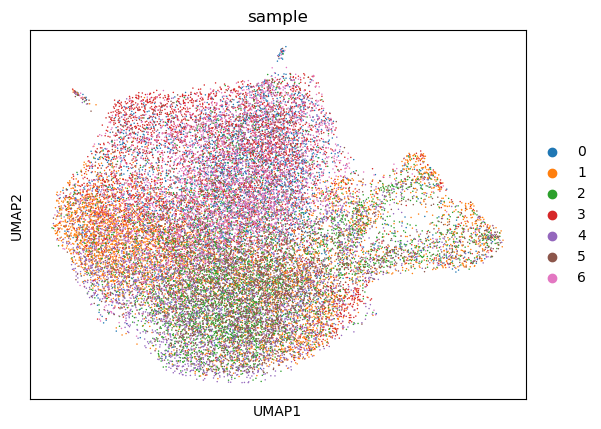

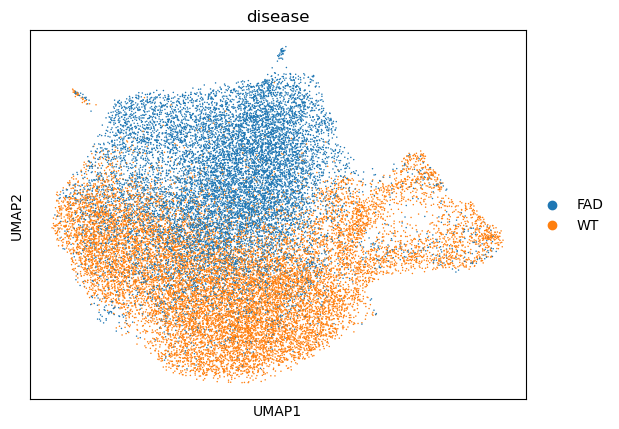

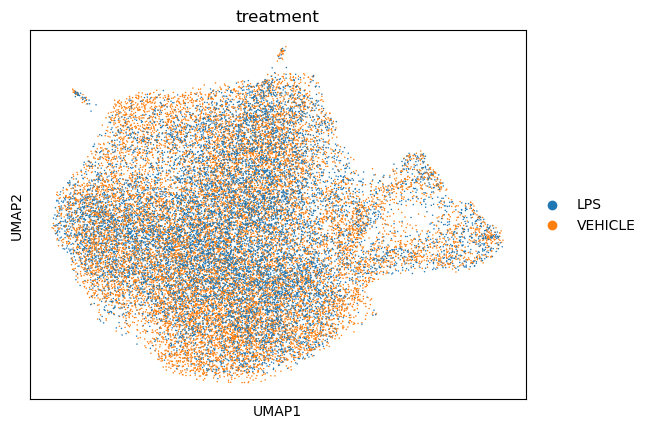

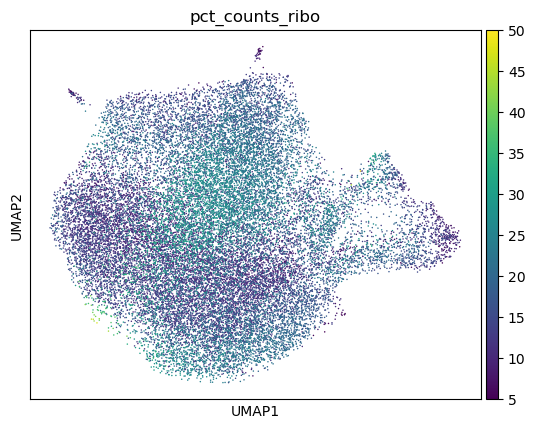

In [35]:
adata_full = sc.read_h5ad('../QC_Merge/QC_merge_output_adata.h5ad')

adata_full.X = adata_full.layers['log_norm'].copy()

sc.pp.regress_out(adata_full, ['pct_counts_ribo', 'pct_counts_mt', 'total_counts'])

#Run PCA
sc.pp.pca(adata_full, n_comps=50, svd_solver='arpack')
#Run Neighbors
sc.pp.neighbors(adata_full, n_pcs=15)
#Run UMAP
sc.tl.umap(adata_full)
#Plot UMAP
sc.pl.umap(adata_full, color='sample')
sc.pl.umap(adata_full, color='disease')
sc.pl.umap(adata_full, color='treatment')
sc.pl.umap(adata_full, color='pct_counts_ribo')


In [34]:
# import gc
# gc.collect()


45505

# MG-Only Dataset



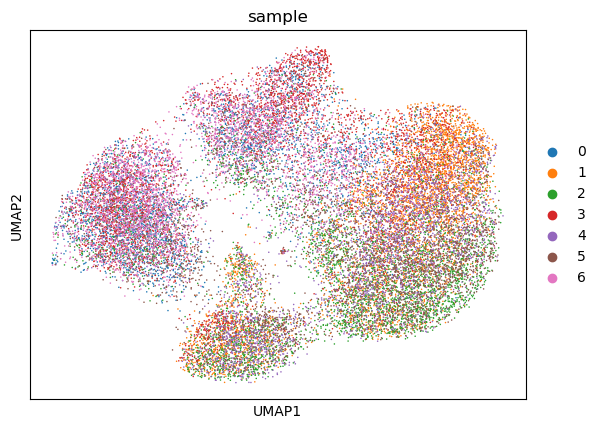

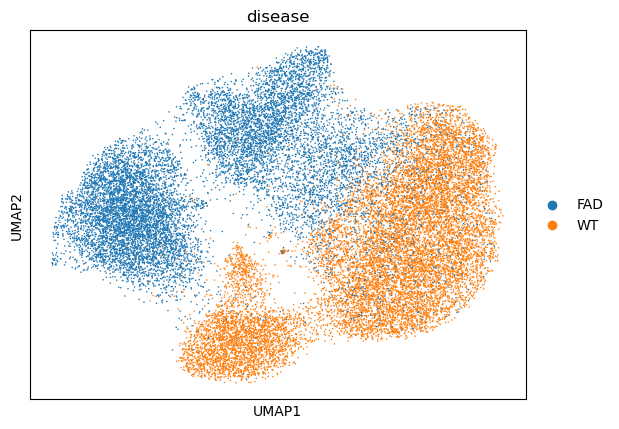

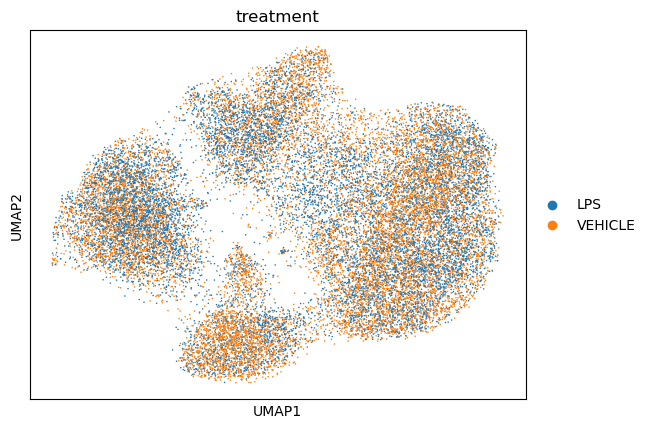

KeyError: 'Could not find key  manual_annotation in .var_names or .obs.columns.'

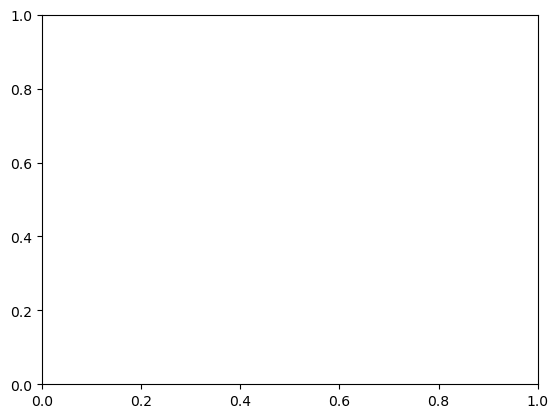

In [56]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()

sc.pp.pca(adata_mg_only)

sc.pp.neighbors(adata_mg_only, n_pcs=15)

sc.tl.umap(adata_mg_only)

sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')





## BBKNN 

In [61]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

# check the data
print(adata_mg_only)

# check Current Layer, should not be normalized

print(adata_mg_only.X.toarray().max())

AnnData object with n_obs × n_vars = 24747 × 17352
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'n_genes', 'Classification', 'most_likely_hypothesis', 'sample', 'genotype', 'apoe', 'disease', 'treatment', 'norm_total_counts', 'genotype_treatment', 'S_score', 'G2M_score', 'phase', 'cellcycle', 'celltypist', 'manual_annotation', 'umap_density_genotype_treatment', 'umap_density_genotype', 'umap_density_phase'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    layers: 'counts', 'log_norm'
7.434137


7.434137


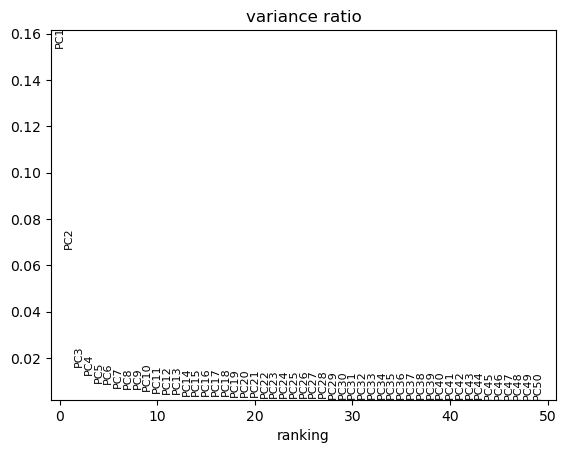

In [62]:
# start by changing the Layer to log_norm
adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()
print(adata_mg_only.X.toarray().max())

# Now we will run the PCA
sc.pp.pca(adata_mg_only)
sc.pl.pca_variance_ratio(adata_mg_only, n_pcs=50)

In [63]:
bbknn(adata_mg_only, batch_key='sample', n_pcs=15)

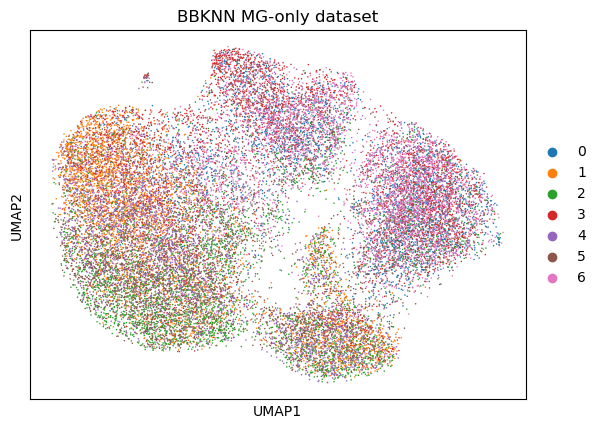

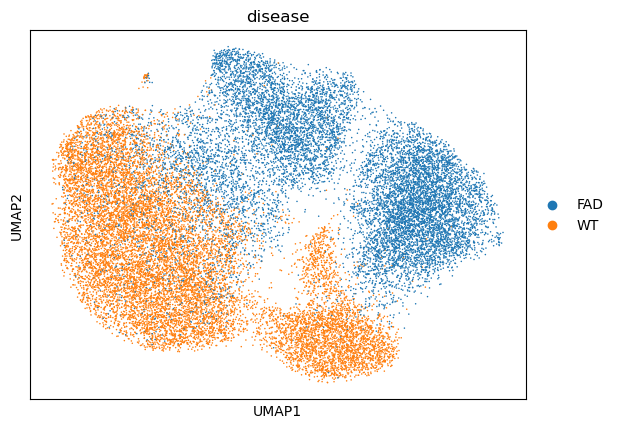

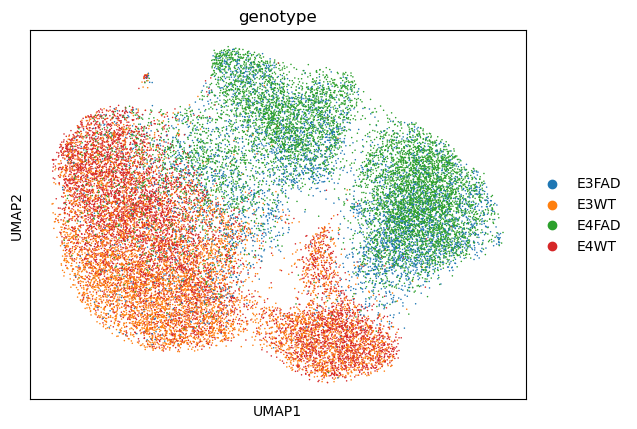

In [64]:
sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample', title='BBKNN MG-only dataset')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='genotype')

In [65]:
# save the bbknn corrected data as a anndata object
bbknn_mg_only_corrected = adata_full.copy()

## ComBat

In [40]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()

Found 21 genes with zero variance.


/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_combat.py:352: RuntimeWarning: invalid value encountered in divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()
/Users/loganlarlham/miniforge3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_combat.py:352: RuntimeWarning: divide by zero encountered in divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()


Highly variable genes: 1405


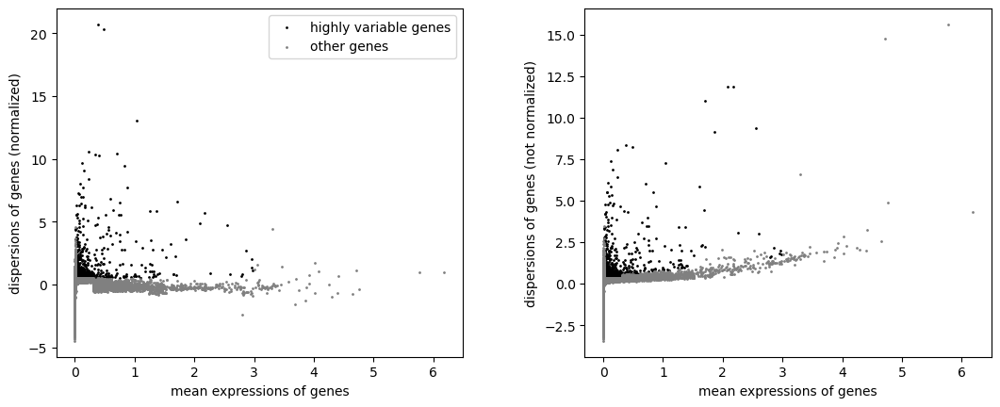

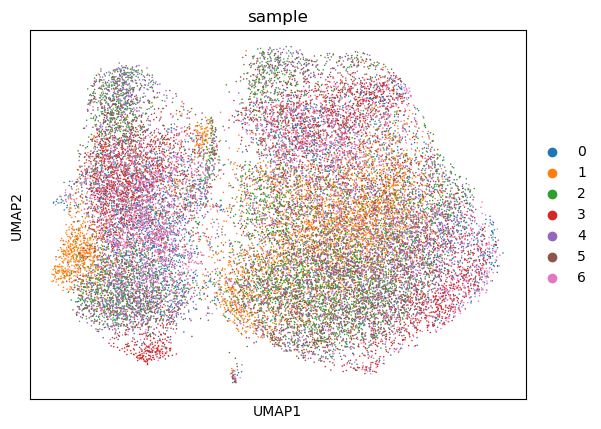

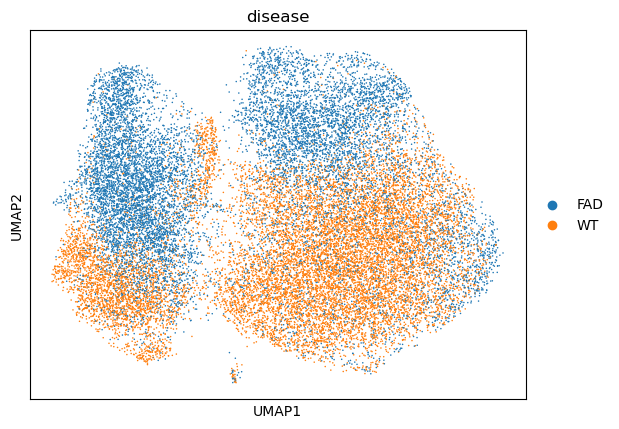

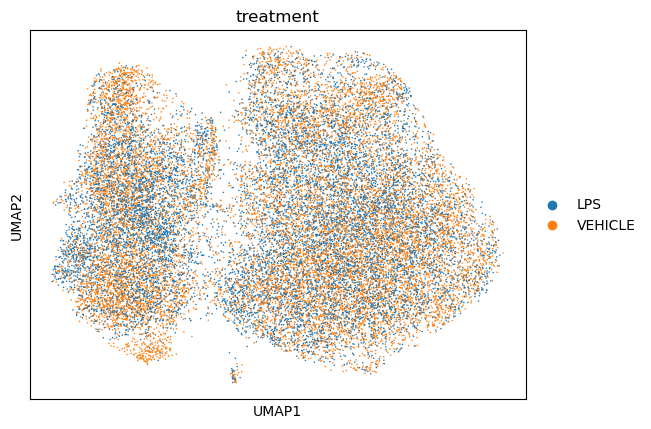

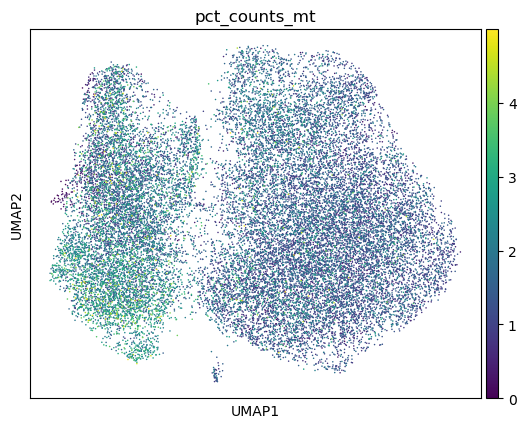

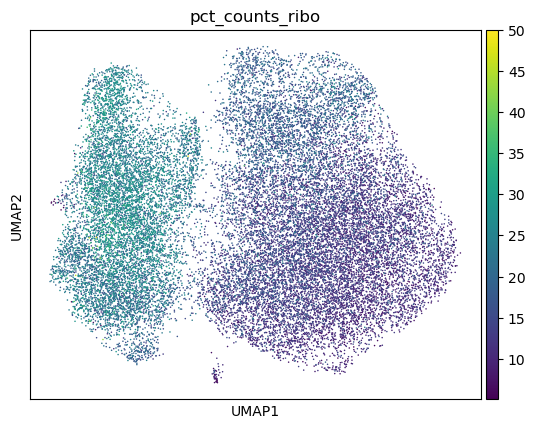

In [41]:
sc.pp.combat(adata_mg_only, key='sample')

sc.pp.highly_variable_genes(adata_mg_only)
print("Highly variable genes: %d"%sum(adata_mg_only.var.highly_variable))
sc.pl.highly_variable_genes(adata_mg_only)

sc.pp.pca(adata_mg_only, mask_var="highly_variable", svd_solver='arpack')

sc.pp.neighbors(adata_mg_only, n_pcs=15, use_rep='X_pca')

sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')
sc.pl.umap(adata_mg_only, color='pct_counts_mt')
sc.pl.umap(adata_mg_only, color='pct_counts_ribo')

## Harmony

use the harmony that is integrated into scanpy


2024-10-11 12:53:43,443 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-10-11 12:53:44,867 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-10-11 12:53:44,915 - harmonypy - INFO - Iteration 1 of 10
2024-10-11 12:53:47,429 - harmonypy - INFO - Iteration 2 of 10
2024-10-11 12:53:49,933 - harmonypy - INFO - Converged after 2 iterations


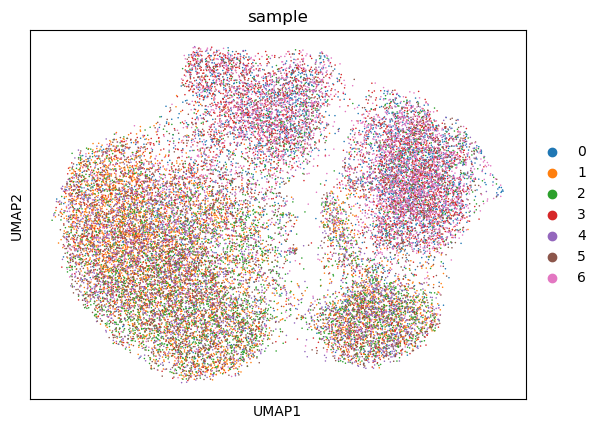

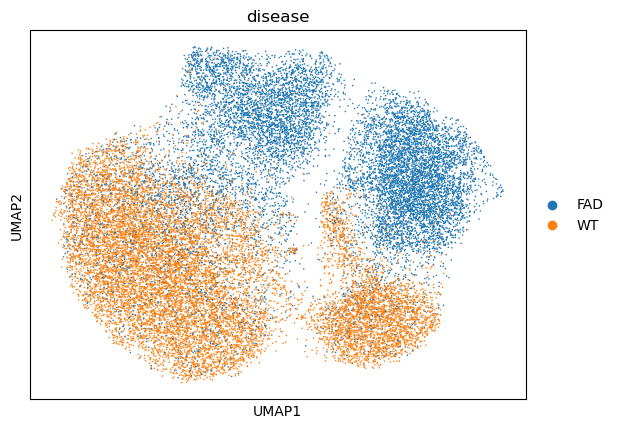

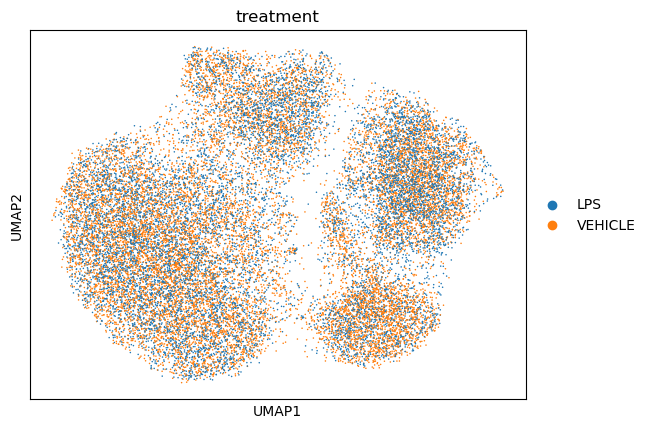

In [74]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()

sc.pp.pca(adata_mg_only, n_comps=50, svd_solver='arpack')

sce.pp.harmony_integrate(adata_mg_only, 'sample')

sc.pp.neighbors(adata_mg_only, n_pcs=15, use_rep='X_pca_harmony')

sc.tl.umap(adata_mg_only)

sc.pl.umap(adata_mg_only, color='sample')

sc.pl.umap(adata_mg_only, color='disease')

sc.pl.umap(adata_mg_only, color='treatment')


## Regress-out

### Mitochondrial

In [42]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()


In [43]:
sc.pp.regress_out(adata_mg_only, 'pct_counts_mt')

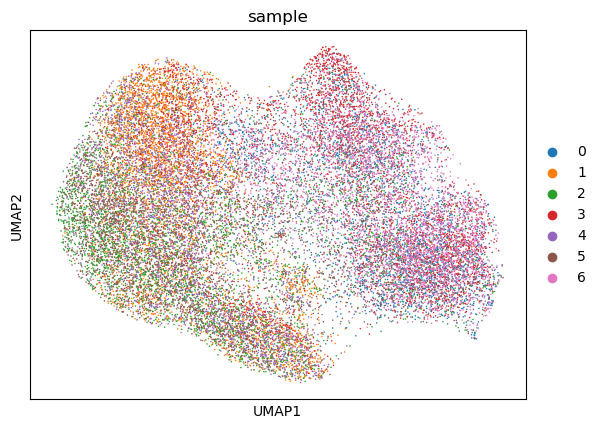

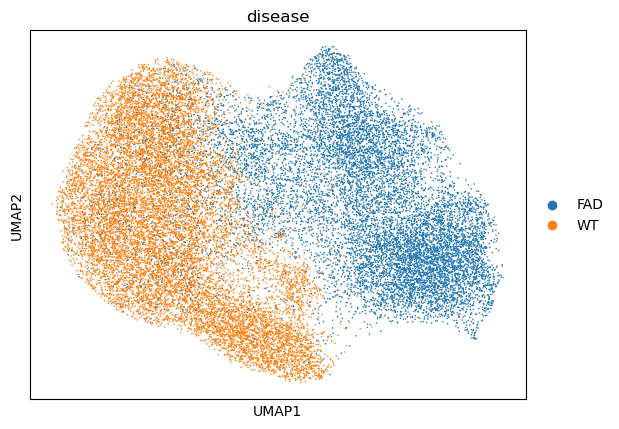

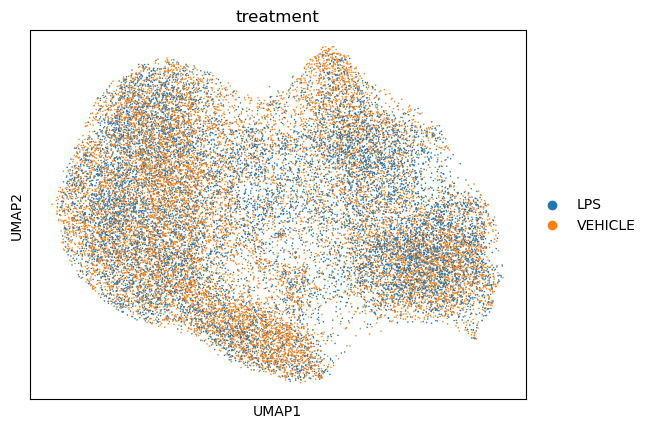

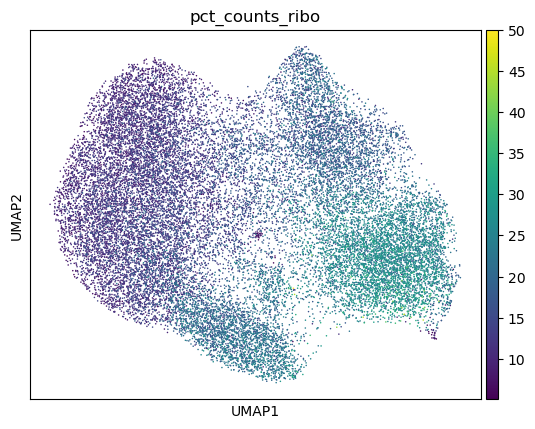

In [44]:
sc.pp.pca(adata_mg_only, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata_mg_only, n_pcs=15)
sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')
sc.pl.umap(adata_mg_only, color='pct_counts_ribo')


### Mt regress on BBKNN-corrected

In [69]:
sc.pp.regress_out(bbknn_mg_only_corrected, 'pct_counts_ribo')

NameError: name 'bbknn_mg_only_corrected' is not defined

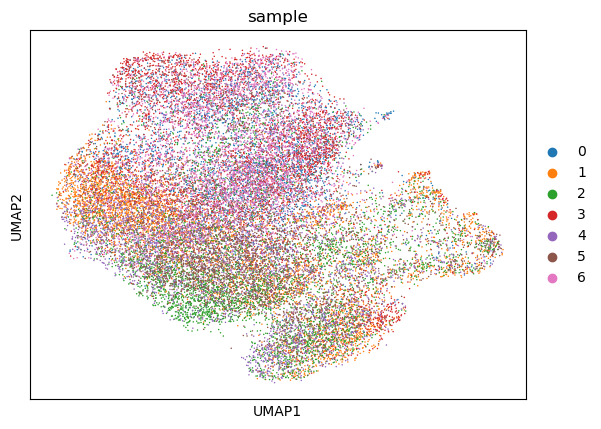

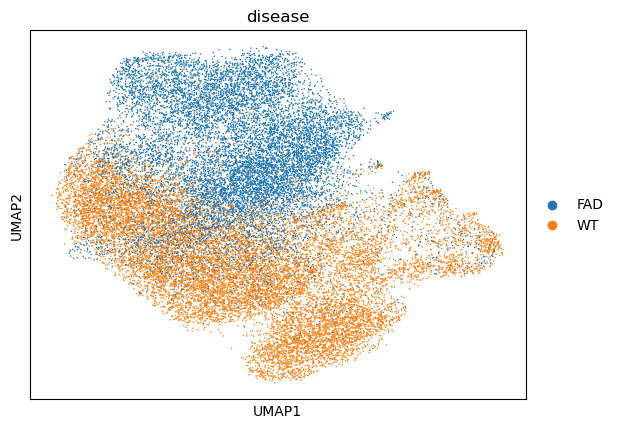

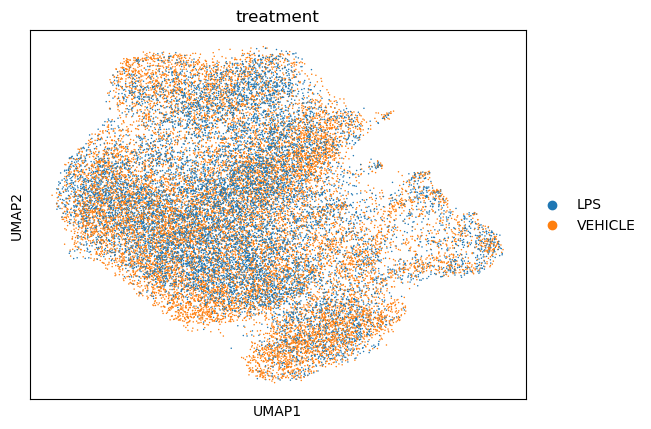

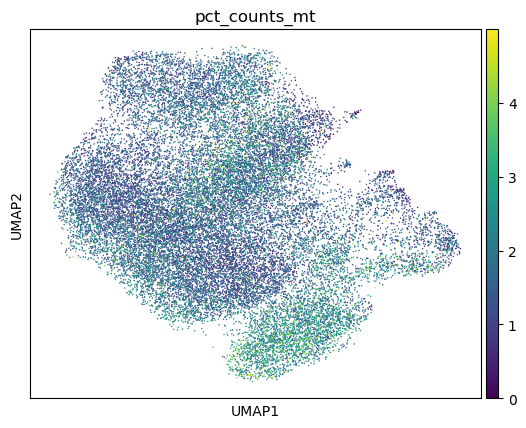

In [67]:
sc.pp.pca(bbknn_mg_only_corrected, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(bbknn_mg_only_corrected, n_pcs=15)
sc.tl.umap(bbknn_mg_only_corrected)
sc.pl.umap(bbknn_mg_only_corrected, color='sample')
sc.pl.umap(bbknn_mg_only_corrected, color='disease')
sc.pl.umap(bbknn_mg_only_corrected, color='treatment')
sc.pl.umap(bbknn_mg_only_corrected, color='pct_counts_mt')


In [68]:
del bbknn_mg_only_corrected

### Ribosomal

In [45]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()


In [46]:
sc.pp.regress_out(adata_mg_only, 'pct_counts_ribo')

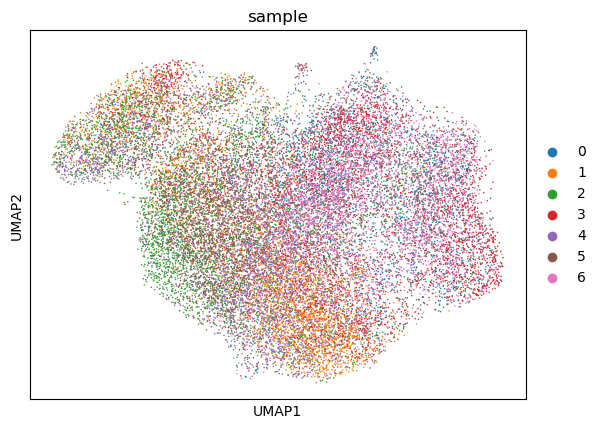

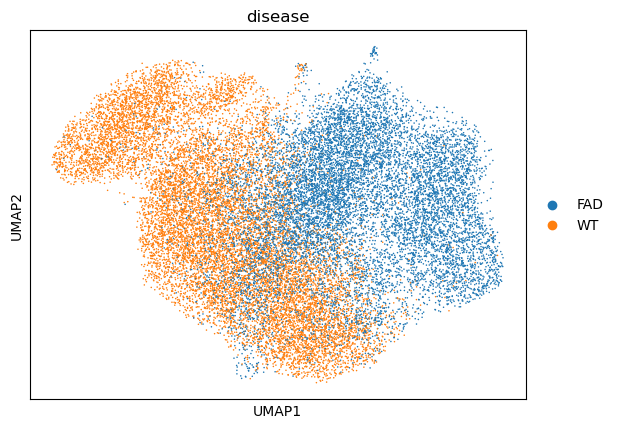

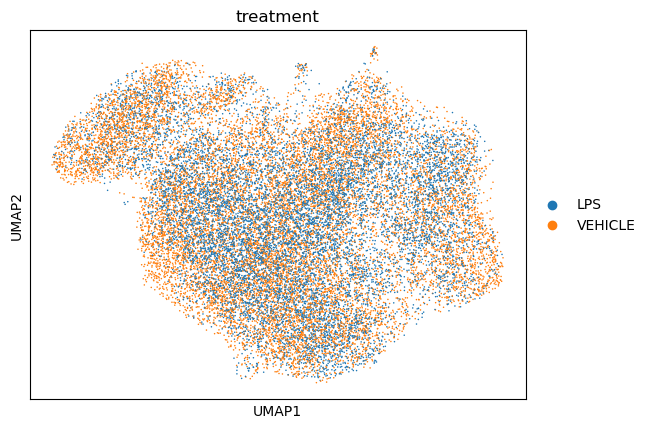

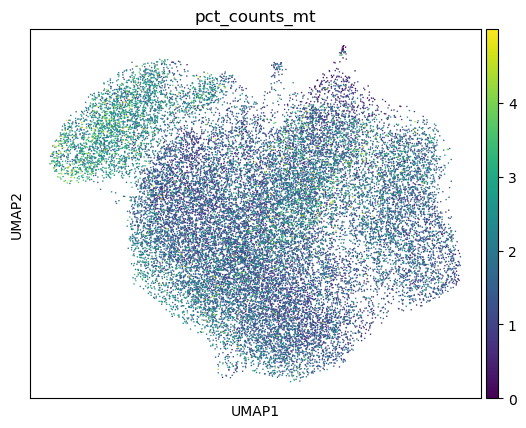

In [47]:
sc.pp.pca(adata_mg_only, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata_mg_only, n_pcs=15)
sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')
sc.pl.umap(adata_mg_only, color='pct_counts_mt')


### Total Counts

In [48]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()


In [49]:
sc.pp.regress_out(adata_mg_only, 'total_counts')

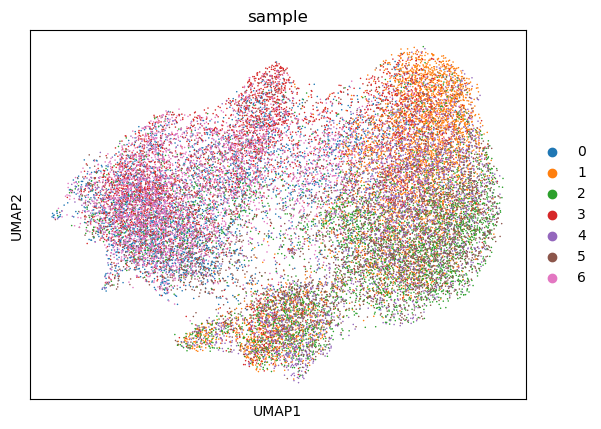

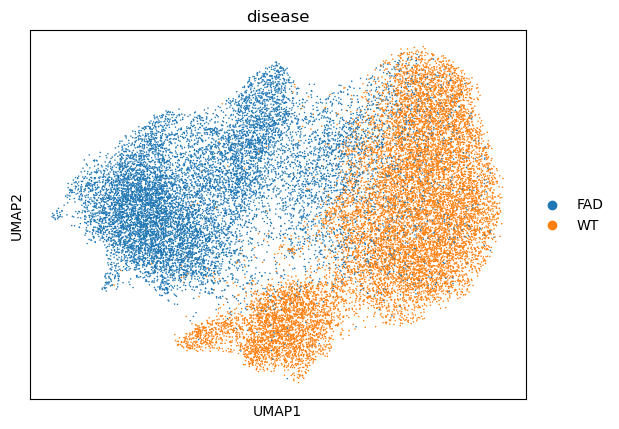

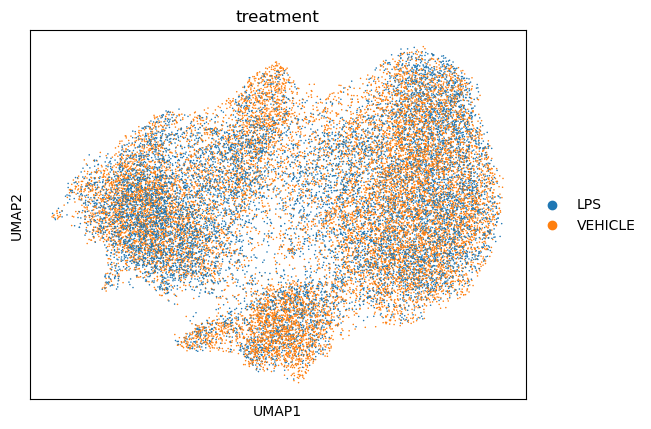

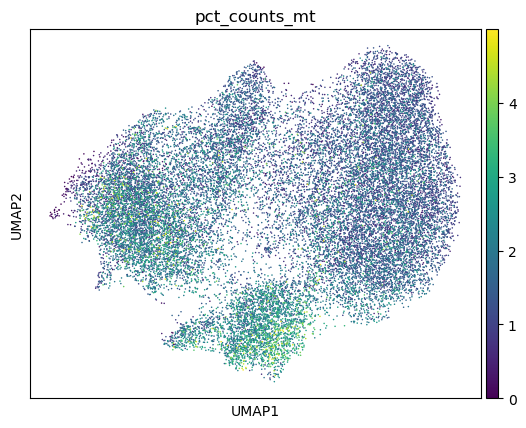

In [50]:
sc.pp.pca(adata_mg_only, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata_mg_only, n_pcs=15)
sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')
sc.pl.umap(adata_mg_only, color='pct_counts_mt')


### Mt + ribo

In [57]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()

In [58]:
sc.pp.regress_out(adata_mg_only, ['pct_counts_ribo', 'pct_counts_mt'])

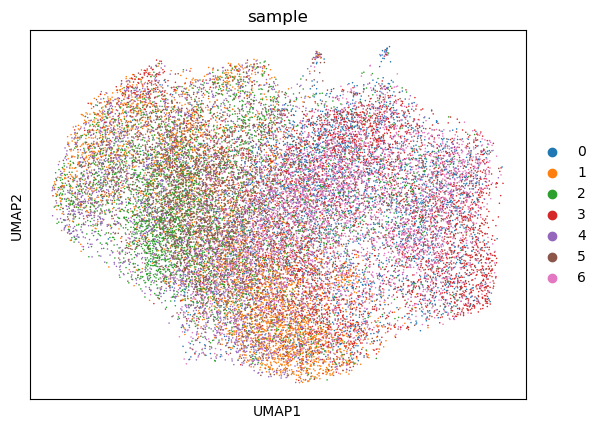

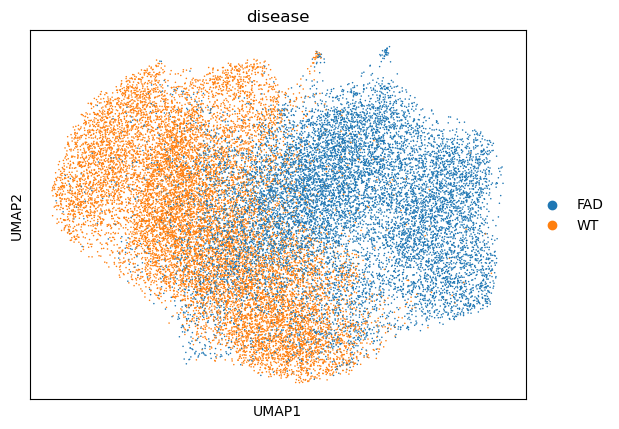

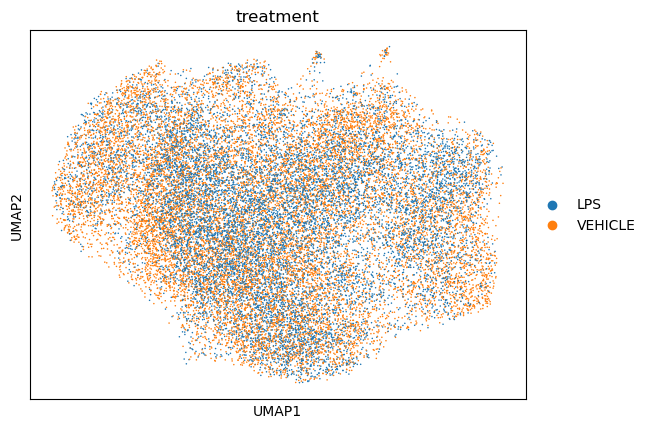

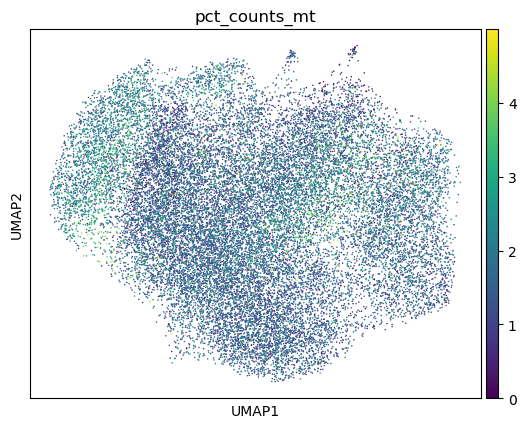

In [59]:
sc.pp.pca(adata_mg_only, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata_mg_only, n_pcs=15)
sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')
sc.pl.umap(adata_mg_only, color='pct_counts_mt')


### Mt + ribo + TC regress out

In [51]:
adata_mg_only = sc.read_h5ad('../Analysis/adata_mg_only.h5ad')

adata_mg_only.X = adata_mg_only.layers['log_norm'].copy()


In [52]:
sc.pp.regress_out(adata_mg_only, ['total_counts', 'pct_counts_ribo', 'pct_counts_mt'])

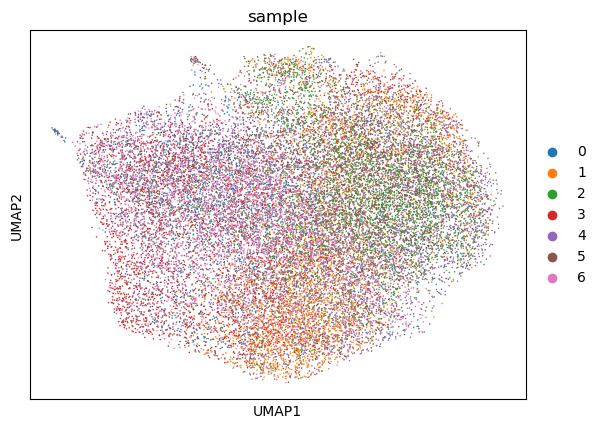

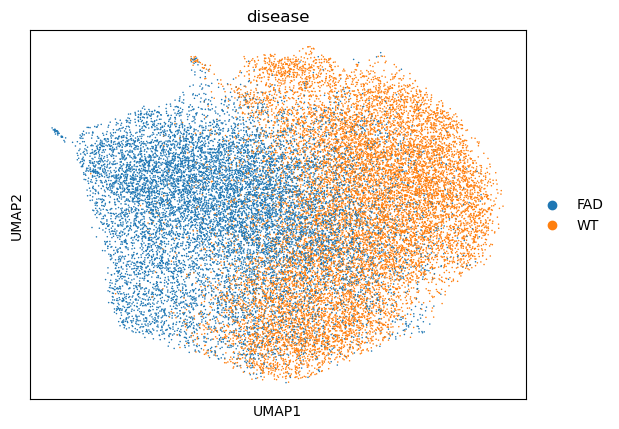

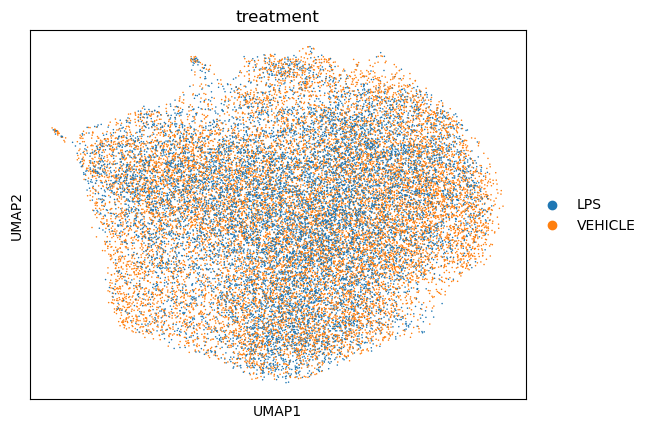

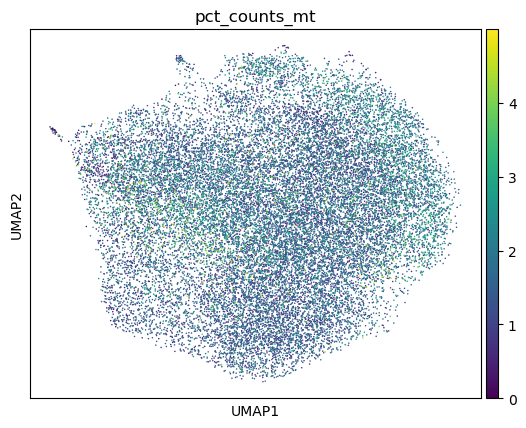

In [53]:
sc.pp.pca(adata_mg_only, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata_mg_only, n_pcs=15)
sc.tl.umap(adata_mg_only)
sc.pl.umap(adata_mg_only, color='sample')
sc.pl.umap(adata_mg_only, color='disease')
sc.pl.umap(adata_mg_only, color='treatment')
sc.pl.umap(adata_mg_only, color='pct_counts_mt')
